<a href="https://colab.research.google.com/github/techn-0/Digital_Imaging/blob/main/audio_pitch_augmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 오디오 데이터 증강 - 음의 높낮이 조절 (Pitch Shifting)
## Librosa를 활용한 오디오 증강

**목표**: 원본 오디오를 1000개로 음높이 변환 증강
- 증강 방법: 피치 시프팅 (Pitch Shifting)
- 피치 범위: -12 ~ +12 반음 (semitones)
- 증강 단계: 1000단계
- 간격: 0.024 반음씩 증가

**사용 라이브러리**:
- Librosa: 오디오 분석 및 변환
- NumPy: 수치 계산
- Matplotlib: 시각화
- Soundfile: 오디오 파일 저장

## 1. 라이브러리 설치 및 임포트

In [1]:
# 필요한 라이브러리 설치
!pip install librosa soundfile matplotlib numpy scipy

In [2]:
import librosa
import librosa.display
import soundfile as sf
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import os
from google.colab import files
import zipfile
from tqdm import tqdm
from IPython.display import Audio, display

print(f"Librosa 버전: {librosa.__version__}")
print(f"NumPy 버전: {np.__version__}")

Librosa 버전: 0.11.0
NumPy 버전: 2.0.2


## 2. 디렉토리 설정 및 오디오 업로드

In [3]:
# 디렉토리 생성
os.makedirs('original_audio', exist_ok=True)
os.makedirs('pitch_augmented', exist_ok=True)
os.makedirs('pitch_results', exist_ok=True)

print("디렉토리 생성 완료")
print("- original_audio: 원본 오디오 저장")
print("- pitch_augmented: 피치 변환된 오디오 저장")
print("- pitch_results: 분석 결과 저장")

디렉토리 생성 완료
- original_audio: 원본 오디오 저장
- pitch_augmented: 피치 변환된 오디오 저장
- pitch_results: 분석 결과 저장


In [4]:
# 오디오 파일 업로드
print("원본 오디오 파일을 업로드해주세요 (.wav, .mp3, .flac 등)...")
uploaded = files.upload()

# 업로드된 파일을 original_audio 폴더로 이동
for filename in uploaded.keys():
    os.rename(filename, f'original_audio/{filename}')
    print(f"✓ {filename} 저장 완료")

# 원본 오디오 목록 확인
audio_extensions = ['.wav', '.mp3', '.flac', '.ogg', '.m4a']
original_audios = list(Path('original_audio').glob('*'))
original_audios = [str(audio) for audio in original_audios if audio.suffix.lower() in audio_extensions]

print(f"\n총 {len(original_audios)}개의 원본 오디오가 준비되었습니다.")

원본 오디오 파일을 업로드해주세요 (.wav, .mp3, .flac 등)...


Saving 솔루션스 (THE SOLUTIONS) - 혼 [가사Lyrics] (mp3cut.net).mp3 to 솔루션스 (THE SOLUTIONS) - 혼 [가사Lyrics] (mp3cut.net).mp3
✓ 솔루션스 (THE SOLUTIONS) - 혼 [가사Lyrics] (mp3cut.net).mp3 저장 완료

총 1개의 원본 오디오가 준비되었습니다.


## 3. 피치 시프팅 증강 파라미터 설정

### 목표: 1000개 생성
- 피치 범위: -12 ~ +12 반음 (한 옥타브 아래 ~ 한 옥타브 위)
- 증강 단계: 1000단계
- 간격: 0.024 반음씩 증가

In [5]:
# 피치 시프팅 파라미터 정의
PITCH_SHIFTS = np.linspace(-12, 12, 1000)  # 1000단계
TARGET_COUNT = 1000

print(f"피치 변환 단계: {len(PITCH_SHIFTS)}개")
print(f"피치 범위: {PITCH_SHIFTS[0]:.2f} ~ {PITCH_SHIFTS[-1]:.2f} 반음")
print(f"피치 간격: {PITCH_SHIFTS[1] - PITCH_SHIFTS[0]:.4f} 반음")
print(f"\n총 생성될 오디오: {len(PITCH_SHIFTS)}개")

# 샘플 피치 값 출력
print(f"\n[샘플 피치 값]")
print(f"  -12 반음 (1 옥타브 아래): {PITCH_SHIFTS[0]:.2f}")
print(f"  -6 반음 (반 옥타브 아래): {PITCH_SHIFTS[250]:.2f}")
print(f"  0 반음 (원본): {PITCH_SHIFTS[500]:.2f}")
print(f"  +6 반음 (반 옥타브 위): {PITCH_SHIFTS[750]:.2f}")
print(f"  +12 반음 (1 옥타브 위): {PITCH_SHIFTS[999]:.2f}")

피치 변환 단계: 1000개
피치 범위: -12.00 ~ 12.00 반음
피치 간격: 0.0240 반음

총 생성될 오디오: 1000개

[샘플 피치 값]
  -12 반음 (1 옥타브 아래): -12.00
  -6 반음 (반 옥타브 아래): -5.99
  0 반음 (원본): 0.01
  +6 반음 (반 옥타브 위): 6.02
  +12 반음 (1 옥타브 위): 12.00


## 4. 피치 시프팅 알고리즘

### 수학적 원리

피치 시프팅은 오디오 신호의 주파수를 변경하면서 시간 길이는 유지하는 기법입니다.

**기본 공식**:
$$f_{new} = f_{original} \times 2^{n/12}$$

여기서:
- $f_{new}$: 변환된 주파수
- $f_{original}$: 원본 주파수
- $n$: 반음 개수 (semitones)

### 구현 방법
1. **Librosa**: `librosa.effects.pitch_shift()` 함수 사용
2. **Phase Vocoder**: 시간-주파수 영역에서 위상 조정

In [6]:
def augment_pitch_shift(audio, sr, n_steps):
    """
    Librosa를 사용한 피치 시프팅

    Args:
        audio: 오디오 신호 (numpy array)
        sr: 샘플링 레이트
        n_steps: 변환할 반음 개수 (-12 ~ +12)

    Returns:
        augmented_audio: 피치가 변환된 오디오
    """
    # Librosa의 pitch_shift 함수 사용
    # n_steps: 반음 단위로 피치 변환
    # 양수: 높은 음, 음수: 낮은 음
    augmented = librosa.effects.pitch_shift(
        y=audio,
        sr=sr,
        n_steps=n_steps
    )

    return augmented

print("✓ 피치 시프팅 함수 정의 완료")

✓ 피치 시프팅 함수 정의 완료


## 5. 원본 오디오 분석 및 시각화

오디오 파일: 솔루션스 (THE SOLUTIONS) - 혼 [가사Lyrics] (mp3cut.net).mp3
샘플링 레이트: 44100 Hz
길이: 29.19 초
샘플 개수: 1,287,407

원본 오디오:


/tmp/ipython-input-16617218.py:33: UserWarning: Glyph 49884 (\N{HANGUL SYLLABLE SI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-16617218.py:33: UserWarning: Glyph 44036 (\N{HANGUL SYLLABLE GAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-16617218.py:33: UserWarning: Glyph 52488 (\N{HANGUL SYLLABLE CO}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-16617218.py:33: UserWarning: Glyph 51652 (\N{HANGUL SYLLABLE JIN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-16617218.py:33: UserWarning: Glyph 54253 (\N{HANGUL SYLLABLE POG}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-16617218.py:33: UserWarning: Glyph 50896 (\N{HANGUL SYLLABLE WEON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-16617218.py:33: UserWarning: Glyph 48376 (\N{HANGUL SYLLABLE BON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-i

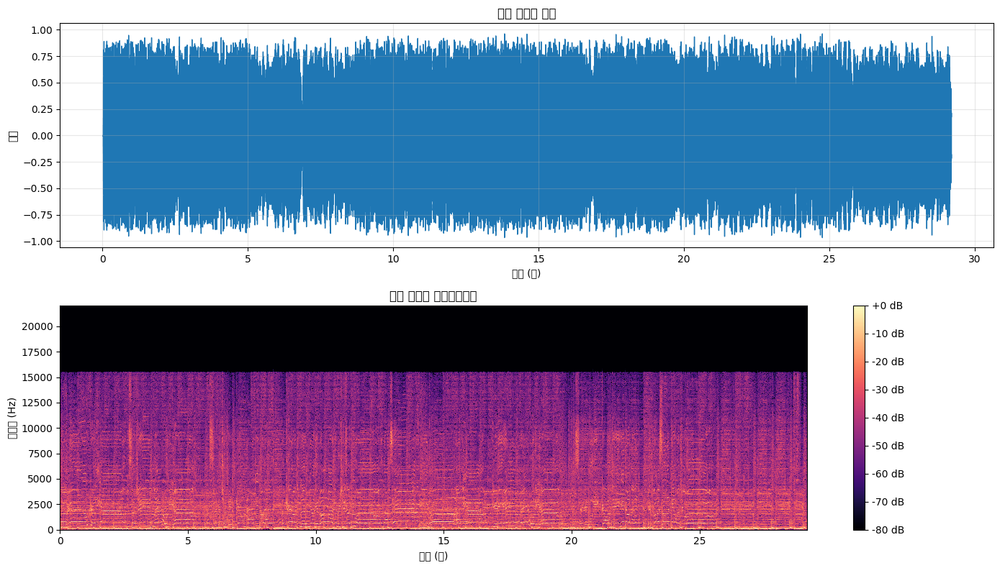

✓ 원본 오디오 분석 저장: pitch_results/original_analysis.png


In [7]:
# 첫 번째 원본 오디오 로드 및 분석
if len(original_audios) > 0:
    sample_audio_path = original_audios[0]
    sample_audio, sample_sr = librosa.load(sample_audio_path, sr=None)

    print(f"오디오 파일: {Path(sample_audio_path).name}")
    print(f"샘플링 레이트: {sample_sr} Hz")
    print(f"길이: {len(sample_audio) / sample_sr:.2f} 초")
    print(f"샘플 개수: {len(sample_audio):,}")

    # 원본 오디오 재생
    print("\n원본 오디오:")
    display(Audio(sample_audio, rate=sample_sr))

    # 파형 시각화
    fig, axes = plt.subplots(2, 1, figsize=(14, 8))

    # 파형 (Waveform)
    librosa.display.waveshow(sample_audio, sr=sample_sr, ax=axes[0])
    axes[0].set_title('원본 오디오 파형', fontsize=12, fontweight='bold')
    axes[0].set_xlabel('시간 (초)')
    axes[0].set_ylabel('진폭')
    axes[0].grid(True, alpha=0.3)

    # 스펙트로그램 (Spectrogram)
    D = librosa.amplitude_to_db(np.abs(librosa.stft(sample_audio)), ref=np.max)
    img = librosa.display.specshow(D, sr=sample_sr, x_axis='time', y_axis='hz', ax=axes[1])
    axes[1].set_title('원본 오디오 스펙트로그램', fontsize=12, fontweight='bold')
    axes[1].set_xlabel('시간 (초)')
    axes[1].set_ylabel('주파수 (Hz)')
    fig.colorbar(img, ax=axes[1], format='%+2.0f dB')

    plt.tight_layout()
    plt.savefig('pitch_results/original_analysis.png', dpi=150, bbox_inches='tight')
    plt.show()

    print("✓ 원본 오디오 분석 저장: pitch_results/original_analysis.png")
else:
    print("⚠ 원본 오디오를 먼저 업로드해주세요.")

## 6. 피치 변환 샘플 생성 및 비교

피치 변환 샘플 생성 중...

피치 -12 반음:


피치 -6 반음:


피치 -3 반음:


피치 +0 반음:


피치 +3 반음:


피치 +6 반음:


피치 +12 반음:


/tmp/ipython-input-1850369210.py:28: UserWarning: Glyph 49884 (\N{HANGUL SYLLABLE SI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-1850369210.py:28: UserWarning: Glyph 44036 (\N{HANGUL SYLLABLE GAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-1850369210.py:28: UserWarning: Glyph 52488 (\N{HANGUL SYLLABLE CO}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-1850369210.py:28: UserWarning: Glyph 51452 (\N{HANGUL SYLLABLE JU}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-1850369210.py:28: UserWarning: Glyph 54028 (\N{HANGUL SYLLABLE PA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-1850369210.py:28: UserWarning: Glyph 49688 (\N{HANGUL SYLLABLE SU}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-1850369210.py:28: UserWarning: Glyph 54588 (\N{HANGUL SYLLABLE PI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/

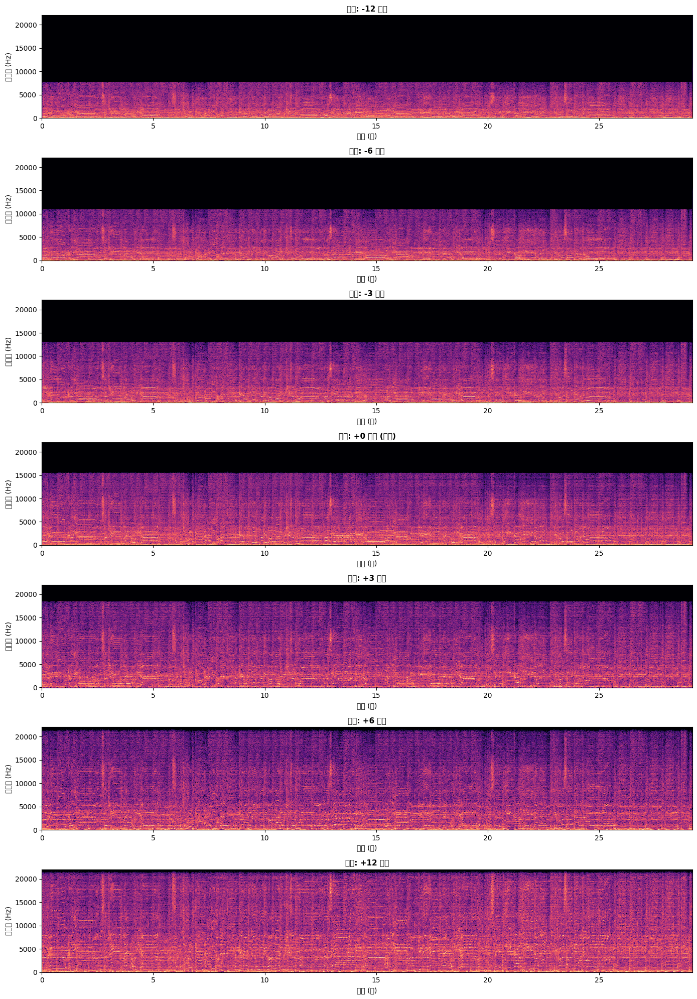


✓ 피치 비교 이미지 저장: pitch_results/pitch_comparison.png


In [8]:
# 대표적인 피치 변환 샘플 생성
if len(original_audios) > 0:
    test_pitches = [-12, -6, -3, 0, 3, 6, 12]

    fig, axes = plt.subplots(len(test_pitches), 1, figsize=(14, 20))

    print("피치 변환 샘플 생성 중...\n")

    for idx, pitch in enumerate(test_pitches):
        # 피치 변환
        augmented = augment_pitch_shift(sample_audio, sample_sr, pitch)

        # 스펙트로그램 생성
        D = librosa.amplitude_to_db(np.abs(librosa.stft(augmented)), ref=np.max)
        img = librosa.display.specshow(D, sr=sample_sr, x_axis='time', y_axis='hz', ax=axes[idx])

        if pitch == 0:
            axes[idx].set_title(f'피치: {pitch:+.0f} 반음 (원본)', fontsize=11, fontweight='bold')
        else:
            axes[idx].set_title(f'피치: {pitch:+.0f} 반음', fontsize=11, fontweight='bold')
        axes[idx].set_xlabel('시간 (초)')
        axes[idx].set_ylabel('주파수 (Hz)')

        # 오디오 재생
        print(f"피치 {pitch:+.0f} 반음:")
        display(Audio(augmented, rate=sample_sr))

    plt.tight_layout()
    plt.savefig('pitch_results/pitch_comparison.png', dpi=150, bbox_inches='tight')
    plt.show()

    print("\n✓ 피치 비교 이미지 저장: pitch_results/pitch_comparison.png")

## 7. 전체 오디오 피치 시프팅 수행 (1000개 생성)

In [9]:
def perform_pitch_augmentation(audio_paths, output_dir):
    """
    전체 오디오 피치 시프팅 수행

    Args:
        audio_paths: 원본 오디오 경로 리스트
        output_dir: 출력 디렉토리
    """
    total_augmentations = 0
    audios_per_original = len(PITCH_SHIFTS)

    print(f"\n{'='*70}")
    print(f"피치 시프팅 증강 시작")
    print(f"원본 오디오: {len(audio_paths)}개")
    print(f"오디오당 생성 개수: {audios_per_original}개")
    print(f"예상 총 생성 개수: {len(audio_paths) * audios_per_original}개")
    print(f"{'='*70}\n")

    for audio_idx, audio_path in enumerate(audio_paths):
        # 오디오 로드
        audio, sr = librosa.load(audio_path, sr=None)

        audio_name = Path(audio_path).stem
        audio_ext = Path(audio_path).suffix

        print(f"[{audio_idx+1}/{len(audio_paths)}] 처리 중: {audio_name}")
        print(f"  샘플링 레이트: {sr} Hz, 길이: {len(audio)/sr:.2f}초")

        # 모든 피치에 대해 증강
        with tqdm(total=audios_per_original, desc=f"  피치 변환 진행") as pbar:
            for pitch_idx, pitch_shift in enumerate(PITCH_SHIFTS):
                # 피치 변환
                augmented = augment_pitch_shift(audio, sr, pitch_shift)

                # 파일명 생성
                output_filename = f"{audio_name}_pitch_{pitch_idx:04d}_shift{pitch_shift:+.3f}.wav"
                output_path = os.path.join(output_dir, output_filename)

                # WAV 파일로 저장
                sf.write(output_path, augmented, sr)

                total_augmentations += 1
                pbar.update(1)

        print(f"  ✓ {audio_name}: {audios_per_original}개 생성 완료\n")

    print(f"\n{'='*70}")
    print(f"피치 시프팅 증강 완료!")
    print(f"총 생성된 오디오: {total_augmentations}개")
    print(f"저장 위치: {output_dir}")
    print(f"{'='*70}\n")

    return total_augmentations

In [10]:
# 피치 시프팅 증강 수행
total_count = perform_pitch_augmentation(
    original_audios,
    'pitch_augmented'
)


피치 시프팅 증강 시작
원본 오디오: 1개
오디오당 생성 개수: 1000개
예상 총 생성 개수: 1000개

[1/1] 처리 중: 솔루션스 (THE SOLUTIONS) - 혼 [가사Lyrics] (mp3cut.net)
  샘플링 레이트: 44100 Hz, 길이: 29.19초


  피치 변환 진행: 100%|██████████| 1000/1000 [11:09<00:00,  1.49it/s]

  ✓ 솔루션스 (THE SOLUTIONS) - 혼 [가사Lyrics] (mp3cut.net): 1000개 생성 완료


피치 시프팅 증강 완료!
총 생성된 오디오: 1000개
저장 위치: pitch_augmented



## 8. 증강 결과 분석 및 통계

/tmp/ipython-input-471099965.py:36: UserWarning: Glyph 54588 (\N{HANGUL SYLLABLE PI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-471099965.py:36: UserWarning: Glyph 52824 (\N{HANGUL SYLLABLE CI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-471099965.py:36: UserWarning: Glyph 48320 (\N{HANGUL SYLLABLE BYEON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-471099965.py:36: UserWarning: Glyph 54872 (\N{HANGUL SYLLABLE HWAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-471099965.py:36: UserWarning: Glyph 48276 (\N{HANGUL SYLLABLE BEOM}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-471099965.py:36: UserWarning: Glyph 50948 (\N{HANGUL SYLLABLE WI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-471099965.py:36: UserWarning: Glyph 48152 (\N{HANGUL SYLLABLE BAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/

총 증강된 오디오 개수: 1000개
목표 달성: ✓ 성공


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50724 (\N{HANGUL SYLLABLE O}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 46356 (\N{HANGUL SYLLABLE DI}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44060 (\N{HANGUL SYLLABLE GAE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48320 (\N{HANGUL SYLLABLE BYEON}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54872 (\N{HANGUL SYLLABLE HWAN}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/

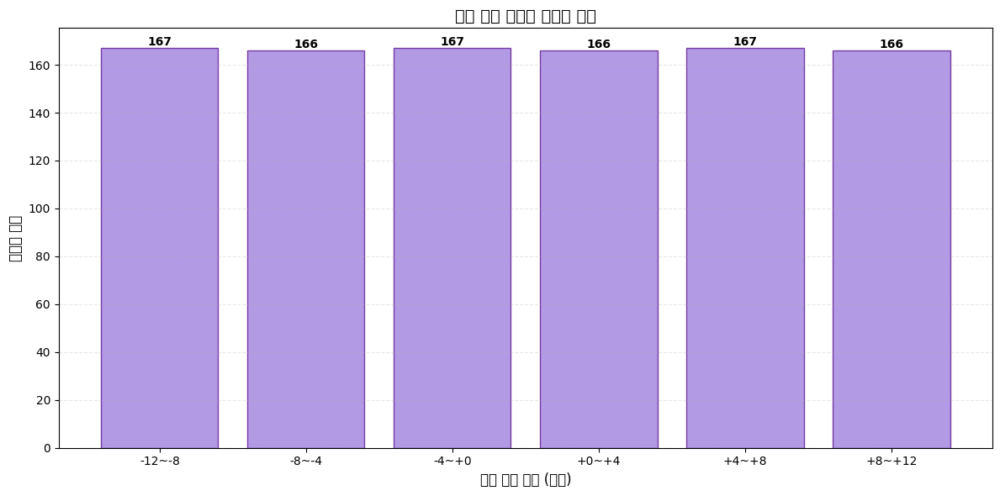

✓ 피치 분포 그래프 저장: pitch_results/pitch_distribution.png


In [11]:
# 생성된 오디오 개수 확인
augmented_files = list(Path('pitch_augmented').glob('*.wav'))
print(f"총 증강된 오디오 개수: {len(augmented_files)}개")
print(f"목표 달성: {'✓ 성공' if len(augmented_files) >= 1000 else '✗ 미달성'}")

# 피치 분포 분석
pitch_distribution = np.zeros(6)  # 6개 구간
bins = [-12, -8, -4, 0, 4, 8, 12]

for file in augmented_files:
    filename = file.stem
    if 'shift' in filename:
        shift_str = filename.split('shift')[1].split('.wav')[0]
        shift_value = float(shift_str)
        for i in range(len(bins)-1):
            if bins[i] <= shift_value < bins[i+1]:
                pitch_distribution[i] += 1
                break

# 분포 시각화
fig, ax = plt.subplots(figsize=(12, 6))

bin_labels = [f"{bins[i]:+.0f}~{bins[i+1]:+.0f}" for i in range(len(bins)-1)]
bars = ax.bar(bin_labels, pitch_distribution, color='mediumpurple', edgecolor='indigo', alpha=0.7)

for bar in bars:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height,
            f'{int(height)}',
            ha='center', va='bottom', fontsize=10, fontweight='bold')

ax.set_title('피치 변환 범위별 오디오 분포', fontsize=14, fontweight='bold')
ax.set_xlabel('피치 변환 범위 (반음)', fontsize=12)
ax.set_ylabel('오디오 개수', fontsize=12)
ax.grid(axis='y', alpha=0.3, linestyle='--')
plt.tight_layout()
plt.savefig('pitch_results/pitch_distribution.png', dpi=150, bbox_inches='tight')
plt.show()

print("✓ 피치 분포 그래프 저장: pitch_results/pitch_distribution.png")

## 9. 주파수 변화 분석

/tmp/ipython-input-2629258036.py:18: UserWarning: Glyph 54588 (\N{HANGUL SYLLABLE PI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-2629258036.py:18: UserWarning: Glyph 52824 (\N{HANGUL SYLLABLE CI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-2629258036.py:18: UserWarning: Glyph 48320 (\N{HANGUL SYLLABLE BYEON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-2629258036.py:18: UserWarning: Glyph 54872 (\N{HANGUL SYLLABLE HWAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-2629258036.py:18: UserWarning: Glyph 48152 (\N{HANGUL SYLLABLE BAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-2629258036.py:18: UserWarning: Glyph 51020 (\N{HANGUL SYLLABLE EUM}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-2629258036.py:18: UserWarning: Glyph 51452 (\N{HANGUL SYLLABLE JU}) missing from font(s) DejaVu Sans.
  plt.tight_layout()

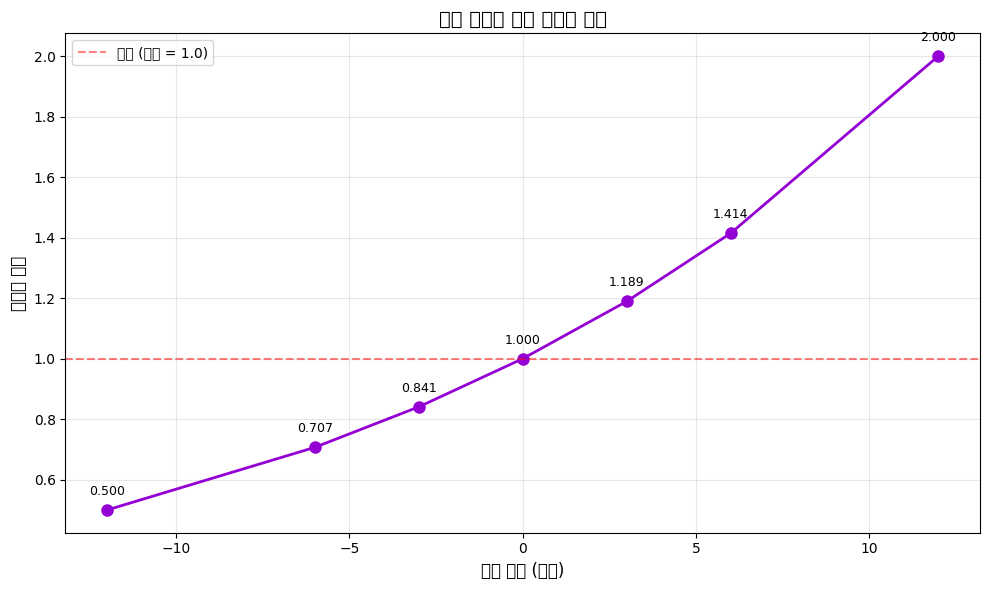

✓ 주파수 비율 분석 저장: pitch_results/frequency_ratio_analysis.png


In [12]:
# 피치 변환에 따른 주파수 비율 계산
pitch_values = np.array([-12, -6, -3, 0, 3, 6, 12])
frequency_ratios = 2 ** (pitch_values / 12)

fig, ax = plt.subplots(figsize=(10, 6))

ax.plot(pitch_values, frequency_ratios, 'o-', linewidth=2, markersize=8, color='darkviolet')
ax.axhline(y=1.0, color='red', linestyle='--', alpha=0.5, label='원본 (비율 = 1.0)')
ax.grid(True, alpha=0.3)

for pitch, ratio in zip(pitch_values, frequency_ratios):
    ax.text(pitch, ratio + 0.05, f'{ratio:.3f}', ha='center', fontsize=9)

ax.set_title('피치 변환에 따른 주파수 비율', fontsize=14, fontweight='bold')
ax.set_xlabel('피치 변환 (반음)', fontsize=12)
ax.set_ylabel('주파수 비율', fontsize=12)
ax.legend()
plt.tight_layout()
plt.savefig('pitch_results/frequency_ratio_analysis.png', dpi=150, bbox_inches='tight')
plt.show()

print("✓ 주파수 비율 분석 저장: pitch_results/frequency_ratio_analysis.png")

## 10. 결과 다운로드

In [13]:
# 증강된 오디오를 ZIP 파일로 압축
zip_filename = 'pitch_augmented_audios.zip'

print("ZIP 파일 생성 중...")
with zipfile.ZipFile(zip_filename, 'w', zipfile.ZIP_DEFLATED) as zipf:
    for file in tqdm(augmented_files, desc="압축 진행"):
        zipf.write(file, file.name)

print(f"\n✓ ZIP 파일 생성 완료: {zip_filename}")
print(f"파일 크기: {os.path.getsize(zip_filename) / (1024*1024):.2f} MB")

# 다운로드
files.download(zip_filename)
print("\n다운로드가 시작되었습니다!")

ZIP 파일 생성 중...


압축 진행: 100%|██████████| 1000/1000 [02:30<00:00,  6.63it/s]


✓ ZIP 파일 생성 완료: pitch_augmented_audios.zip
파일 크기: 2372.57 MB


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


다운로드가 시작되었습니다!
